In [1]:
import os
import chromadb.utils.embedding_functions as embedding_functions
from helper_utils import load_chroma, word_wrap
from chromadb.utils.embedding_functions import SentenceTransformerEmbeddingFunction

## 如果报错：SSLError:(MaxRetryEror("SOCKSHTTPSomectionpool(host='huggingface.co', port-443)，注意挂上梯子并添加以下代码：
# http://127.0.0.1:1080/pac?auth=6kW2t5wCi1UNt1VioOiy&t=202404181401516765
os.environ['HTTPS_PROXY'] = 'http://127.0.0.1:1080/pac?auth=6kW2t5wCi1UNt1VioOiy&t=202404181401516765' # 7890改为自己的梯子端口
os.environ["HTTP_PROXY"]  = 'http://127.0.0.1:1080/pac?auth=6kW2t5wCi1UNt1VioOiy&t=202404181401516765'

# 读取OpenAI的api key
from dotenv import load_dotenv, find_dotenv
_ = load_dotenv(find_dotenv()) 
openai_api_key = os.environ['OPENAI_API_KEY']

# chromadb支持的嵌入函数有许多种，这里介绍常用的几种：
# 参考资料：https://docs.trychroma.com/embeddings
# 方式1：默认嵌入函数，需要下载模型，本地计算。英文文本表现不错，中文文本表现一般
# embedding_function = SentenceTransformerEmbeddingFunction()

# 方式2：OpenAI的嵌入函数，直接调用OpenAI的接口，无需下载模型，推荐
embedding_function = embedding_functions.OpenAIEmbeddingFunction(
                api_key=openai_api_key,
                model_name="text-embedding-ada-002"
            )

# 方式3：HuggingFace的嵌入函数，需要下载模型，本地计算，对网络要求高
# embedding_function = embedding_functions.HuggingFaceEmbeddingFunction(
#     api_key="hf_",  # 填入你的 huggingface Access Token
#     model_name="jinaai/jina-embeddings-v2-base-zh"  # 指定模型
# )
## 中文备选模型
# jinaai/jina-embeddings-v2-base-zh
# GanymedeNil/text2vec-large-chinese
# BAAI/bge-large-zh-v1.5
# BAAI/bge-small-zh-v1.5


# 初始化chroma，英文文档
# chroma_collection = load_chroma(filename='./data/microsoft_annual_report_2022.pdf', \
#                                 collection_name='microsoft_annual_report_2022', \
#                                 embedding_function=embedding_function,
#                                 langcode='en')

# 初始化chroma，中文文档
chroma_collection = load_chroma(filename='./data/2024年北京市政府工作报告.pdf', \
                                collection_name='beijing_annual_report_2024', \
                                embedding_function=embedding_function,
                                langcode='zh')  # 注意中文文档将langcode改为'zh'
chroma_collection.count()

ModuleNotFoundError: No module named 'chromadb'

In [3]:
import umap
import numpy as np
from tqdm import tqdm

# 获取整个数据集的嵌入
embeddings     = chroma_collection.get(include=['embeddings'])['embeddings']
# 定义UMAP模型
umap_transform = umap.UMAP(random_state=0, transform_seed=0).fit(embeddings)

d:\python_env\py310\lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [27]:
embeddings

[[-0.024130946025252342,
  -0.014172350987792015,
  0.015572573989629745,
  -0.028763459995388985,
  -0.03740034997463226,
  0.011836464516818523,
  -0.017365382984280586,
  0.0006453130627050996,
  0.0007622709381394088,
  -0.018412278965115547,
  0.026957564055919647,
  -0.004619427490979433,
  -0.01612219400703907,
  -0.003608518745750189,
  -0.01923670805990696,
  -0.015428625978529453,
  0.013871368020772934,
  -0.012621636502444744,
  0.029758010059595108,
  0.008754665032029152,
  0.024157118052244186,
  0.004926952999085188,
  0.0018418821273371577,
  -0.0015793403144925833,
  -0.016540952026844025,
  0.007393701002001762,
  0.014865919016301632,
  -0.023097136989235878,
  0.003175038378685713,
  0.004609612748026848,
  0.0008481491240672767,
  -0.014002230018377304,
  0.014551850035786629,
  -0.010043655522167683,
  -0.011738318018615246,
  -0.024261808022856712,
  -0.019433001056313515,
  -0.0032650060020387173,
  -0.0034187687560915947,
  -0.002283541252836585,
  -0.00426610

In [4]:
def project_embeddings(embeddings, umap_transform):
    """
    用 UMAP 将高维嵌入向量投影到二维向量空间。
    
    Args:
        embeddings (list): 高维嵌入向量。
        umap_transform (umap.UMAP): UMAP模型。

    Returns:
        umap_embeddings (np.ndarray): 二维嵌入向量矩阵。
    """
    
    umap_embeddings = np.empty((len(embeddings),2))
    # 为保证结果可复现，逐个进行umap转换
    for i, embedding in enumerate(tqdm(embeddings)): 
        umap_embeddings[i] = umap_transform.transform([embedding])

    return umap_embeddings   

In [5]:
len(embeddings), len(embeddings[0])

(1028, 1536)

In [6]:
projected_dataset_embeddings = project_embeddings(embeddings, umap_transform)
print(f'Before UMAP: {np.array(embeddings).shape}')
print(f'After UMAP: {projected_dataset_embeddings.shape}')

100%|██████████| 1028/1028 [10:04<00:00,  1.70it/s]

Before UMAP: (1028, 1536)
After UMAP: (1028, 2)


(2.421052634716034, 9.080853521823883, 6.905082368850708, 14.442727422714233)

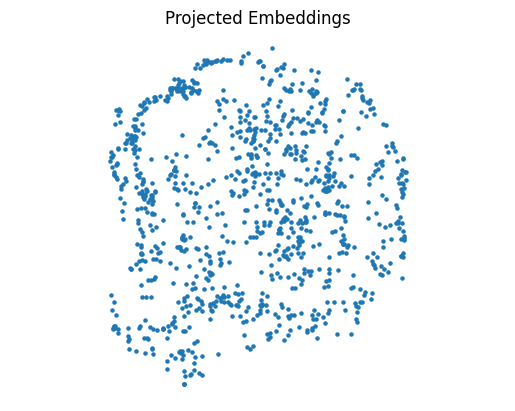

In [7]:
# 绘制散点图
import matplotlib.pyplot as plt

plt.figure()
plt.scatter(projected_dataset_embeddings[:, 0], projected_dataset_embeddings[:, 1], s=5)
plt.gca().set_aspect('equal', 'datalim')
plt.title('Projected Embeddings')
plt.axis('off')

In [8]:
query = "地区生产总值是多少？"

# 输入query，返回 n_results 个最相关的查询结果，results 是一个字典，包含了查询结果的文档和嵌入矩阵（方便后续可视化）
results = chroma_collection.query(query_texts=query, n_results=5, include=['documents', 'embeddings'])

# 检索结果
retrieved_documents = results['documents'][0]

# 查看检索结果
for document in results['documents'][0]:
    print(word_wrap(document))
    print('')

着力打造一批乡村产业强镇、优势特色产业集群

共同打造区域一流营商环境

农业中关村总体框架基本形成

发展新型农村集体经济

开展重点地区环境整
治提升



In [18]:
results['documents'][0]


['着力打造一批乡村产业强镇、优势特色产业集群',
 '共同打造区域一流营商环境',
 '农业中关村总体框架基本形成',
 '发展新型农村集体经济',
 '开展重点地区环境整\n治提升']

In [19]:
query_embedding      = embedding_function([query])[0]  # 查询的嵌入
retrieved_embeddings = results['embeddings'][0]   # 检索的嵌入

# UMAP降维（投影到二维平面）
projected_query_embedding      = project_embeddings([query_embedding], umap_transform)
projected_retrieved_embeddings = project_embeddings(retrieved_embeddings, umap_transform)

100%|██████████| 5/5 [00:02<00:00,  1.91it/s]


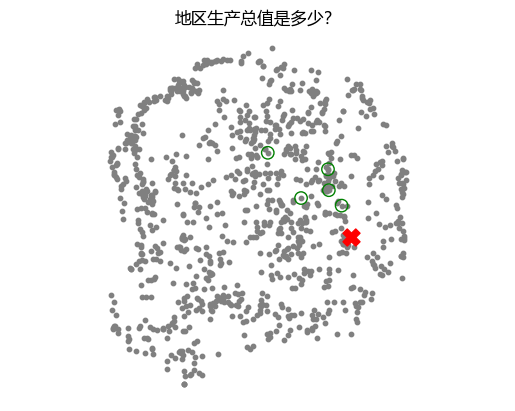

In [20]:
def plot(query, projected_dataset_embeddings, projected_query_embedding, projected_retrieved_embeddings):
    """
    绘制投影后的数据集、查询、检索结果的散点图.
    
    Args:
        query (str): 查询文本。
        projected_dataset_embeddings (np.ndarray): 整个数据集的二维嵌入向量。
        projected_query_embedding (np.ndarray): 查询的二维嵌入向量。
        projected_retrieved_embeddings (np.ndarray): 检索的二维嵌入向量。
    
    Returns:
        None

    """
    plt.figure()
    plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']  # 设置全局字体为微软雅黑，显示中文
    plt.scatter(projected_dataset_embeddings[:, 0], projected_dataset_embeddings[:, 1], s=10, color='gray') # 整个数据集的散点图
    plt.scatter(projected_query_embedding[:, 0], projected_query_embedding[:, 1], s=150, marker='X', color='r') # 查询的散点图
    plt.scatter(projected_retrieved_embeddings[:, 0], projected_retrieved_embeddings[:, 1], s=80, facecolors='none', edgecolors='g') # 检索的散点图

    plt.gca().set_aspect('equal', 'datalim')
    plt.title(f'{query}')
    plt.axis('off')
    plt.show()

plot(query, projected_dataset_embeddings, projected_query_embedding, projected_retrieved_embeddings)

In [21]:
query   = "一般公共预算收入是多少？"
results = chroma_collection.query(query_texts=query, n_results=5, include=['documents', 'embeddings'])

# 检索结果
retrieved_documents = results['documents'][0]

# 查看检索结果
for document in results['documents'][0]:
    print(word_wrap(document))
    print('')

一般公共预算收入增长5%

一般公共预算收入增长8.2%、突破6000亿元

压减一般性支出和非紧急非刚性支出23.9亿元

“三公”经费减少5%；深化全成本
预算绩效管理改革

统筹用好政府投资基金



100%|██████████| 5/5 [00:02<00:00,  1.86it/s]


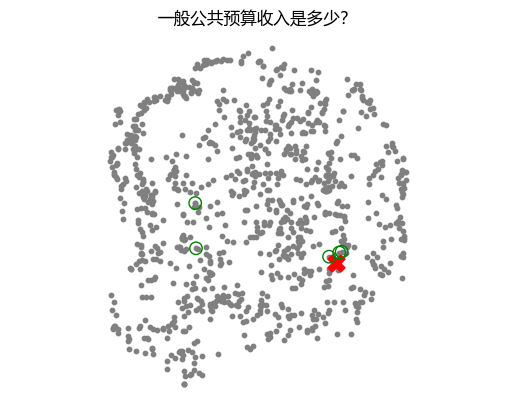

In [22]:
query_embedding      = embedding_function([query])[0]  # 查询的嵌入
retrieved_embeddings = results['embeddings'][0]   # 检索的嵌入

# UMAP降维（投影到二维平面）
projected_query_embedding      = project_embeddings([query_embedding], umap_transform)
projected_retrieved_embeddings = project_embeddings(retrieved_embeddings, umap_transform)

# 绘制散点图
plot(query, projected_dataset_embeddings, projected_query_embedding, projected_retrieved_embeddings)

In [23]:
query   = "城镇新增就业人数多少？"
results = chroma_collection.query(query_texts=query, n_results=5, include=['documents', 'embeddings'])

# 检索结果
retrieved_documents = results['documents'][0]

# 查看检索结果
for document in results['documents'][0]:
    print(word_wrap(document))
    print('')

城镇新增就业28.1万人

实现城镇新增就业不
少于26万人

城镇调查失业
率4.4%

城镇调
查失业率控制在5%以内

持续增加城乡居民收入



100%|██████████| 5/5 [00:03<00:00,  1.65it/s]


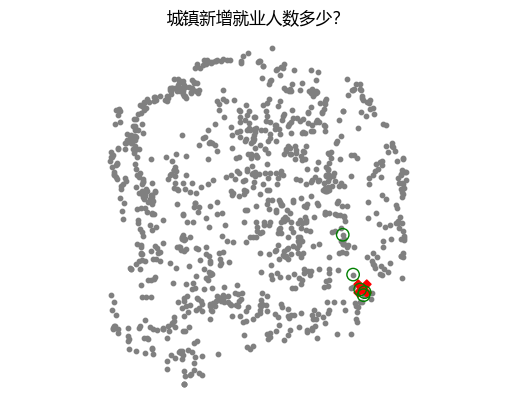

In [24]:
query_embedding      = embedding_function([query])[0]  # 查询的嵌入
retrieved_embeddings = results['embeddings'][0]   # 检索的嵌入

# UMAP降维（投影到二维平面）
projected_query_embedding      = project_embeddings([query_embedding], umap_transform)
projected_retrieved_embeddings = project_embeddings(retrieved_embeddings, umap_transform)

# 绘制散点图
plot(query, projected_dataset_embeddings, projected_query_embedding, projected_retrieved_embeddings)

In [25]:
query = "迈克尔·乔丹最近做了什么？"
results = chroma_collection.query(query_texts=query, n_results=5, include=['documents', 'embeddings'])

# 检索结果
retrieved_documents = results['documents'][0]

# 查看检索结果
for document in results['documents'][0]:
    print(word_wrap(document))
    print('')

深化“一微克”行动

主要做了以下工作

做好新时代北京宗教工作

绿色北京战略实施取得新成效

落实北京与雄安新一轮战略合作协议



100%|██████████| 5/5 [00:02<00:00,  1.68it/s]


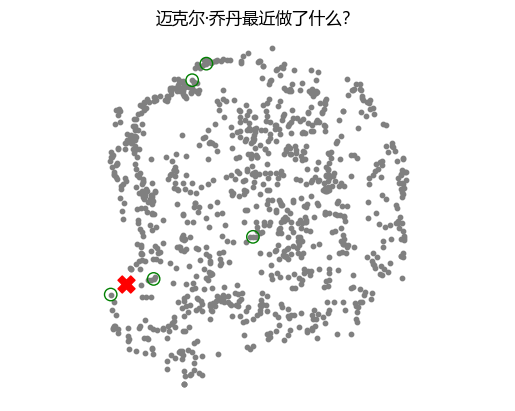

In [26]:
query_embedding      = embedding_function([query])[0]  # 查询的嵌入
retrieved_embeddings = results['embeddings'][0]   # 检索的嵌入

# UMAP降维（投影到二维平面）
projected_query_embedding      = project_embeddings([query_embedding], umap_transform)
projected_retrieved_embeddings = project_embeddings(retrieved_embeddings, umap_transform)

# 绘制散点图
plot(query, projected_dataset_embeddings, projected_query_embedding, projected_retrieved_embeddings)